# Bài toán
* Cài đặt và sử dụng Faster-RCNN
* Thử nghiệm cho 5 ảnh: pedestrian
* Cho biết pedestrian-05 có bao nhiêu person ?
* Xác định confiden score để xác định ít nhất 2 ảnh camourflage, 2 ảnh lính_bắn_tỉa



## Cài đặt và sử dụng Faster-RCNN



In [ ]:
import numpy as np
import cv2
import time
import torch
import torchvision
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Thử nghiệm cho 5 ảnh: pedestrian + Cho biết pedestrian-05 có bao nhiêu person ?

In [ ]:
# Load the pre-trained Faster-RCNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

# Set the model to evaluation mode
model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:00<00:00, 169MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
def human_detection(model, img):
  copy_img = img.copy()
  # Convert the image to a PyTorch tensor
  img_tensor = torchvision.transforms.functional.to_tensor(copy_img)
  # Run the model on the image tensor
  start_time = time.time()
  output = model([img_tensor])
  end_time = time.time()
  inference_time = end_time - start_time
  cnt = 0 # count number of people detected
  print(output[0]['labels'])
  for i in range(len(output[0]['boxes'])):
      # Check if the detected object is a person (class ID 1)
      if output[0]['labels'][i] == 1:
          cnt += 1
          # Get the coordinates of the bounding box
          box = output[0]['boxes'][i]
          # Draw the bounding box on the image
          cv2.rectangle(copy_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)
  
  return copy_img, cnt, inference_time

In [ ]:
# Load the images
pedestrian_img_1 = cv2.imread("/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/pedestrian_01.jpg")
res_img_1, human_cnt_1, inference_time_1 = human_detection(model, pedestrian_img_1)

pedestrian_img_2 = cv2.imread("/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/pedestrian_02.jpg")
res_img_2, human_cnt_2, inference_time_2 = human_detection(model, pedestrian_img_2)

pedestrian_img_3 = cv2.imread("/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/pedestrian-03.jpg")
res_img_3, human_cnt_3, inference_time_3 = human_detection(model, pedestrian_img_3)

pedestrian_img_4 = cv2.imread("/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/pedestrian-04.jpg")
res_img_4, human_cnt_4, inference_time_4 = human_detection(model, pedestrian_img_4)

pedestrian_img_5 = cv2.imread("/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/pedestrian-05.jpg")
res_img_5, human_cnt_5, inference_time_5 = human_detection(model, pedestrian_img_5)

tensor([ 1,  1,  1,  1,  3,  3,  3,  3,  1,  3, 31,  3,  3,  1, 31, 31,  3,  3,
         3, 31,  3,  3, 31,  1,  3, 27,  3, 31,  3,  1,  3,  3,  3,  3, 28,  1,
         3,  3, 31,  3, 31, 32,  1,  1,  3,  1,  3,  8,  1,  3, 31,  3,  3, 27,
        27, 31, 27,  1, 34,  1,  3, 32,  1,  1, 31, 27, 33, 18,  3,  3,  1,  3,
         1,  1, 31, 27, 62,  1,  1,  3, 27,  3,  3, 33, 31, 28, 43, 31, 18, 19,
         3, 32])
tensor([ 1,  1,  1,  1,  1,  1,  1, 31,  1,  3,  1,  1, 31, 31, 10,  1, 31,  1,
        10,  1,  1,  1, 31, 31,  1, 31, 10,  1,  3, 31, 31, 31, 31, 31, 31, 27,
         3, 10, 31,  3, 10, 37, 44, 47, 31, 77, 10, 31, 44, 31,  3, 27,  1, 31,
        10,  1, 31,  1, 31,  1,  1, 31, 31, 77, 31, 47, 27,  3, 77, 31,  3, 31,
         3, 77, 31, 27,  3,  1, 31,  1,  3,  1, 67,  8, 10, 32, 31,  3, 31, 31,
         3, 10])
tensor([ 1,  3,  3, 10, 10, 10, 10, 11,  3, 10, 10, 28,  3, 10,  3, 10,  8,  9,
        11, 10, 27, 10,  3, 49,  9, 10, 10,  1, 14, 27, 10])
tensor([ 1,  1,  1,  1,  

==================== Pedestrian 01 ====================


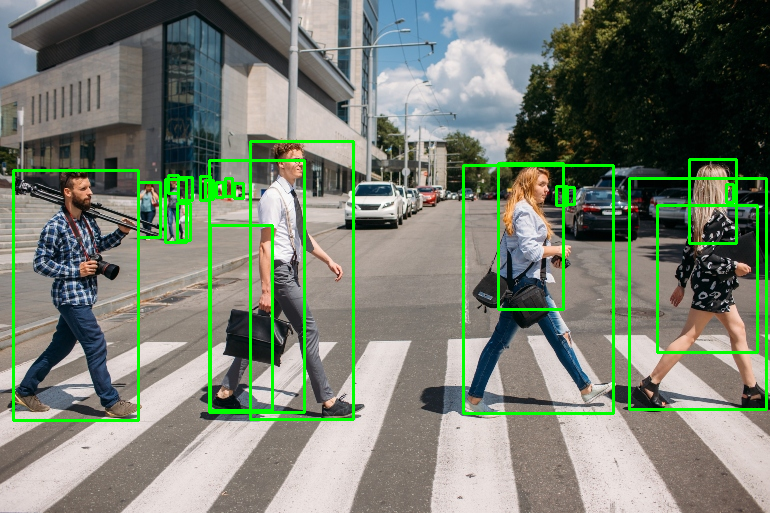

number of detected people in image: 22
the inference time: 10.15s

==================== Pedestrian 02 ====================


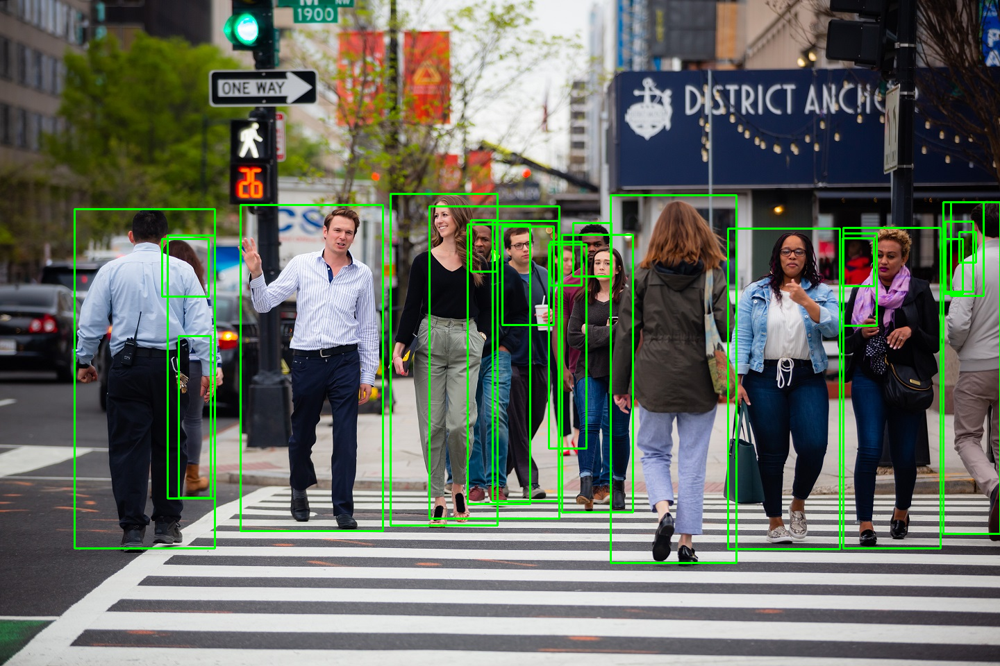

number of detected people in image: 25
the inference time: 9.24s

==================== Pedestrian 03 ====================


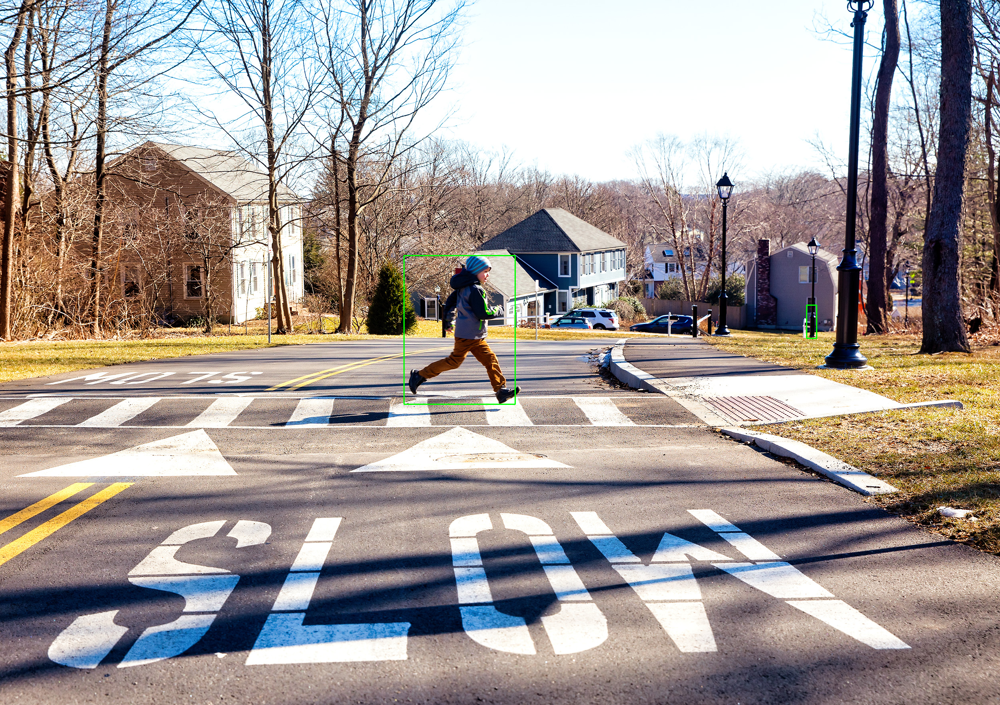

number of detected people in image: 2
the inference time: 7.22s

==================== Pedestrian 04 ====================


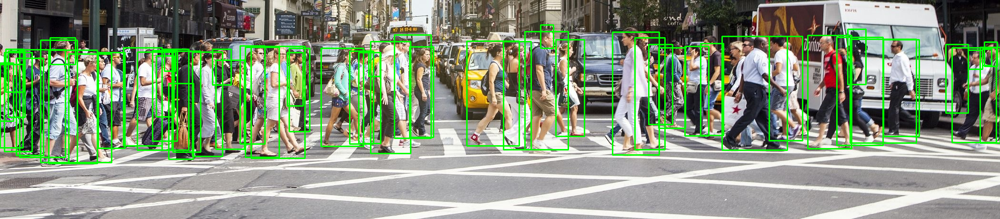

number of detected people in image: 59
the inference time: 5.39s

==================== Pedestrian 05 ====================


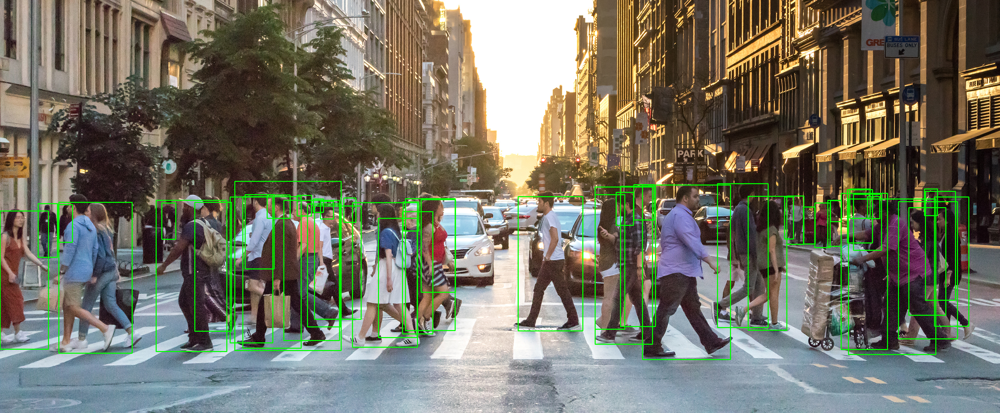

number of detected people in image: 51
the inference time: 6.12s


In [ ]:
# Print the images, people counts & inference time
print("==================== Pedestrian 01 ====================")
cv2_imshow(res_img_1)
print("number of detected people in image: {}".format(human_cnt_1))
print("the inference time: {:.2f}s".format(inference_time_1) + "\n")

print("==================== Pedestrian 02 ====================")
cv2_imshow(res_img_2)
print("number of detected people in image: {}".format(human_cnt_2))
print("the inference time: {:.2f}s".format(inference_time_2) + "\n")

print("==================== Pedestrian 03 ====================")
cv2_imshow(res_img_3)
print("number of detected people in image: {}".format(human_cnt_3))
print("the inference time: {:.2f}s".format(inference_time_3) + "\n")

print("==================== Pedestrian 04 ====================")
cv2_imshow(res_img_4)
print("number of detected people in image: {}".format(human_cnt_4))
print("the inference time: {:.2f}s".format(inference_time_4) + "\n")

print("==================== Pedestrian 05 ====================")
cv2_imshow(res_img_5)
print("number of detected people in image: {}".format(human_cnt_5))
print("the inference time: {:.2f}s".format(inference_time_5))

## Xác định confiden score để xác định ít nhất 2 ảnh camourflage, 2 ảnh lính_bắn_tỉa

In [ ]:
def sniper_detection(img, bbox_thresh):
  
  # Load the pre-trained Faster R-CNN model
  model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, box_score_thresh = bbox_thresh)

  # Set the model to evaluation mode
  model.eval()
  copy_img = img.copy()
  # Convert the image to a PyTorch tensor
  img_tensor = torchvision.transforms.functional.to_tensor(copy_img)
  # Run the model on the image tensor
  start_time = time.time()
  output = model([img_tensor])
  end_time = time.time()
  inference_time = end_time - start_time
  cnt = 0 # count number of people detected
  for i in range(len(output[0]['boxes'])):
      # Check if the detected object is a person (class ID 1)
      if output[0]['labels'][i] == 1:
          cnt += 1
          # Get the coordinates of the bounding box
          box = output[0]['boxes'][i]
          # Draw the bounding box on the image
          cv2.rectangle(copy_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)
  
  return copy_img, cnt, inference_time

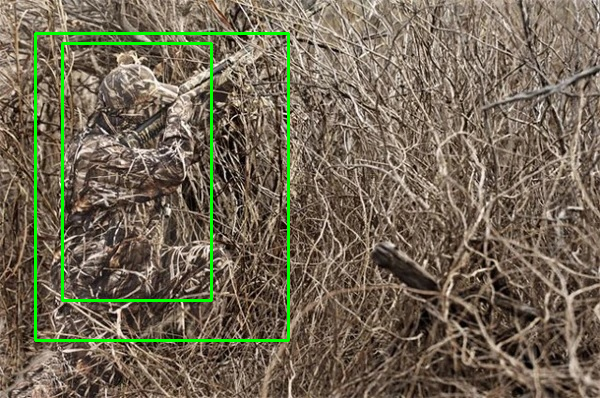

In [ ]:
sniper_image_path_1 = "/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/linh-ban-tia-2.jpg"
sniper_img_1 = cv2.imread(sniper_image_path_1)

bbox_threshold = 0
res_img1, human_cnt1, inference_time1 = sniper_detection(sniper_img_1, bbox_thresh = bbox_threshold)
cv2_imshow(res_img1)

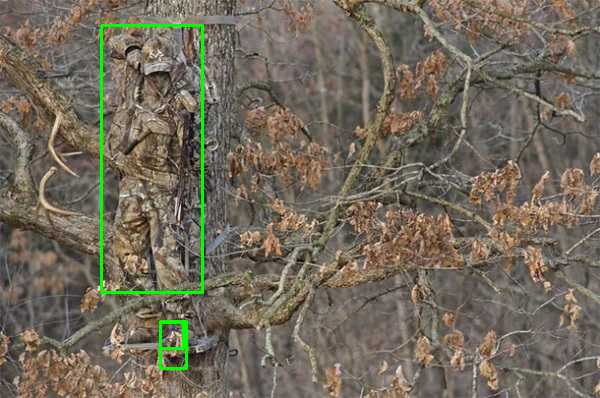

In [ ]:
sniper_image_path_2 = "/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/linh-ban-tia-3.jpg"
sniper_img_2 = cv2.imread(sniper_image_path_2)

bbox_threshold = 0.1
res_img2, human_cnt2, inference_time2 = sniper_detection(sniper_img_2, bbox_thresh = bbox_threshold)
cv2_imshow(res_img2)

In [ ]:
def camourflage_detection(img, bbox_thresh):
  
  # Load the pre-trained Faster R-CNN model
  model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, box_score_thresh = bbox_thresh)

  # Set the model to evaluation mode
  model.eval()
  copy_img = img.copy()
  # Convert the image to a PyTorch tensor
  img_tensor = torchvision.transforms.functional.to_tensor(copy_img)
  # Run the model on the image tensor
  start_time = time.time()
  output = model([img_tensor])
  end_time = time.time()
  inference_time = end_time - start_time
  for i in range(len(output[0]['boxes'])):
          # Get the coordinates of the bounding box
          box = output[0]['boxes'][i]
          # Draw the bounding box on the image
          cv2.rectangle(copy_img, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), (0, 255, 0), 2)
  
  return copy_img, inference_time

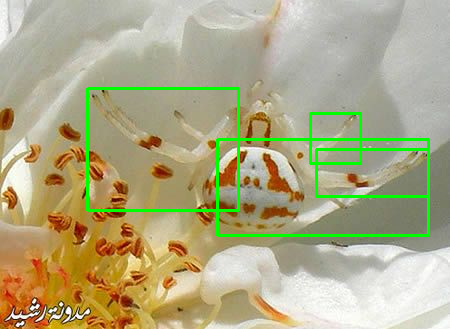

In [ ]:
camou_img_path_1 = "/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/camourflage_00498.jpg"
camou_img_1 = cv2.imread(camou_img_path_1)

bbox_threshold = 0.7
cam_res_1, inference_time1 = camourflage_detection(camou_img_1, bbox_threshold)
cv2_imshow(cam_res_1)

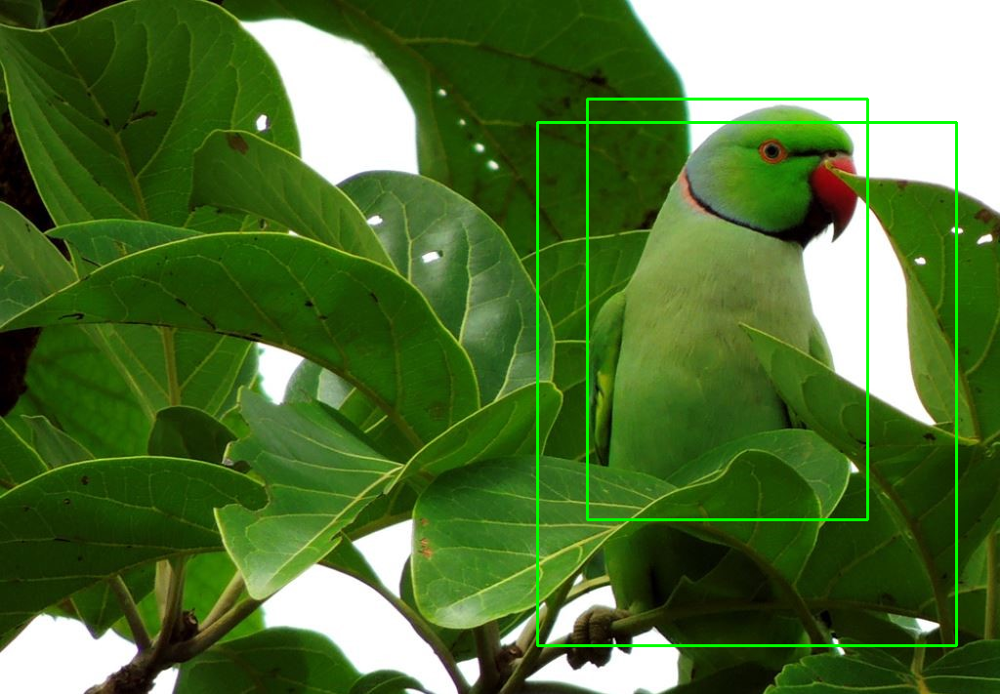

In [ ]:
camou_img_path_1 = "/content/drive/MyDrive/CS331.N21.KHCL/Baitap/Baitap4/images/camourflage_00473.jpg"
camou_img_1 = cv2.imread(camou_img_path_1)

bbox_threshold = 0.7
cam_res_1, inference_time1 = camourflage_detection(camou_img_1, bbox_threshold)
cv2_imshow(cam_res_1)